In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import polars as pl
import numpy as np
import plotly.express as px
import gc

from pathlib import Path

data_dir = Path("/content/drive/MyDrive/Colab Notebooks/Eenefit/data/predict-energy-behavior-of-prosumers")

In [ ]:
df_train = pd.read_csv(data_dir/'train.csv')
df_client = pd.read_csv(data_dir/'client.csv')
#df_gas_prices = pd.read_csv(data_dir/'gas_prices.csv')
#df_electricity_prices = pd.read_csv(data_dir/'electricity_prices.csv')
#df_forecast_weather = pd.read_csv(data_dir/'forecast_weather.csv')
#df_historical_weather = pd.read_csv(data_dir/'historical_weather.csv')
df_weather_station_to_county_map = pd.read_csv(data_dir/'weather_station_to_county_mapping.csv')

In [ ]:
display(df_train.head(3))
df_train.shape

,county,is_business,product_type,target,is_consumption,datetime,data_block_id,row_id,prediction_unit_id
0,0,0,1,0.713,0,2021-09-01 00:00:00,0,0,0
1,0,0,1,96.590,1,2021-09-01 00:00:00,0,1,0
2,0,0,2,0.000,0,2021-09-01 00:00:00,0,2,1


(2018352, 9)

In [ ]:
df_client.head(3)

,product_type,county,eic_count,installed_capacity,is_business,date,data_block_id
0,1,0,108,952.89,0,2021-09-01,2
1,2,0,17,166.40,0,2021-09-01,2
2,3,0,688,7207.88,0,2021-09-01,2


In [ ]:
df_client[
    (df_client.county==0)
    & (df_client.is_business==0)
]['installed_capacity'].max()

15980.56

In [ ]:
df_train = df_train.merge(df_client, how='left', on=["county", "is_business", "product_type", "data_block_id"])
df_train['target_norm'] = df_train['target'] / df_train['installed_capacity']
df_train['target_norm_log'] = np.log1p(df_train['target_norm'])

df_train['target_log'] = np.log1p(df_train['target'])

In [ ]:
df_train.isna().sum()

county                   0
is_business              0
product_type             0
target                 528
is_consumption           0
datetime                 0
data_block_id            0
row_id                   0
prediction_unit_id       0
eic_count             8640
installed_capacity    8640
date                  8640
target_norm           9168
target_norm_log       9168
target_log             528
dtype: int64

In [ ]:
df_train = df_train.dropna()

In [ ]:
df_weather_station_to_county_map.head()

,county_name,longitude,latitude,county
0,NaN,21.7,57.6,NaN
1,NaN,21.7,57.9,NaN
2,NaN,21.7,58.2,NaN
3,NaN,21.7,58.5,NaN
4,NaN,21.7,58.8,NaN


In [ ]:
df_weather_station_to_county_map['size'] = 1

fig = px.scatter_mapbox(
    df_weather_station_to_county_map,
    lat='latitude',
    lon='longitude',
    color='county',
    size='size',
    zoom=6,
    title='Weather Stations Locations'
)

fig.update_layout(mapbox_style='open-street-map')
fig.update_layout(margin={"r":0, "t":30, "l":0, "b":0})
fig.show()

In [ ]:
np.random.randint(2)

0

In [ ]:
#county = np.random.randint(15)
county = 0
is_business = 1
is_consumption = 0

print('county', county)
print('is_business', is_business)
print('is_consumption', is_consumption)

df_plot = df_train[
    (df_train['county'] == county)
    & (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
]

fig = px.line(
    df_plot,
    x='datetime',
    y='target_log',
    color='product_type'
)
fig.show()

county 0
is_business 1
is_consumption 0


In [ ]:
#county = np.random.randint(15)
county = 0
is_business = 1
is_consumption = 0

print('county', county)
print('is_business', is_business)
print('is_consumption', is_consumption)

df_plot = df_train[
    (df_train['county'] == county)
    & (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
]

fig = px.line(
    df_plot,
    x='datetime',
    y='target_norm_log',
    color='product_type'
)
fig.show()

county 0
is_business 1
is_consumption 0


In [ ]:
#county = np.random.randint(15)
county = 13
is_business = 1
is_consumption = 0

print('county', county)
print('is_business', is_business)
print('is_consumption', is_consumption)

df_plot = df_train[
    (df_train['county'] == county)
    & (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
]

fig = px.line(
    df_plot,
    x='datetime',
    y='installed_capacity',
    color='product_type'
)
fig.show()

county 13
is_business 1
is_consumption 0


In [ ]:
#county = np.random.randint(15)
county = 13
is_business = 1
is_consumption = 0

print('county', county)
print('is_business', is_business)
print('is_consumption', is_consumption)

df_plot = df_train[
    (df_train['county'] == county)
    & (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
]

fig = px.line(
    df_plot,
    x='datetime',
    y='target',
    color='product_type'
)
fig.show()

county 13
is_business 1
is_consumption 0


In [ ]:
#county = np.random.randint(15)
county = 8
is_business = 0
is_consumption = 1

print('county', county)
print('is_business', is_business)
print('is_consumption', is_consumption)

df_plot = df_train[
    (df_train['county'] == county)
    & (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
]

fig = px.line(
    df_plot,
    x='datetime',
    #y='target',
    y='target_norm',
    color='product_type'
)
fig.show()

county 8
is_business 0
is_consumption 1


In [ ]:
product_type = 3
is_business =  1
is_consumption = 0

df_plot = df_train[
    (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
    & (df_train['product_type'] == product_type)
]

fig = px.line(
    df_plot,
    x="datetime",
    y="target",
    color='county',
    title=f'Target for is_busines={is_business}, is_consumption={is_consumption}, product_type={product_type}'
)
fig.show()

In [ ]:
product_type = 3
is_business =  1
is_consumption = 0

df_plot = df_train[
    (df_train['is_business'] == is_business)
    & (df_train['is_consumption'] == is_consumption)
    & (df_train['product_type'] == product_type)
]

fig = px.line(
    df_plot,
    x="datetime",
    y="target_norm",
    color='county',
    title=f'Target for is_busines={is_business}, is_consumption={is_consumption}, product_type={product_type}'
)
fig.show()

In [ ]:
df_train[
    (df_train.county == 13)
    #& (df_train.is_business == 0)
    #& (df_train.is_consumption == 0)
    & (df_train.product_type == 3)
    & (df_train.data_block_id > 622)
    & (df_train.data_block_id < 624)
]

,county,is_business,product_type,target,is_consumption,datetime,data_block_id,row_id,prediction_unit_id,eic_count,installed_capacity,date,target_norm,target_norm_log,target_log
1970748,13,0,3,1.518,0,2023-05-17 00:00:00,623,1970748,51,88.0,1155.43,2023-05-15,0.001314,0.001313,0.923465
1970749,13,0,3,64.605,1,2023-05-17 00:00:00,623,1970749,51,88.0,1155.43,2023-05-15,0.055914,0.054407,4.183652
1970752,13,1,3,0.000,0,2023-05-17 00:00:00,623,1970752,52,39.0,1523.20,2023-05-15,0.000000,0.000000,0.000000
1970753,13,1,3,191.064,1,2023-05-17 00:00:00,623,1970753,52,39.0,1523.20,2023-05-15,0.125436,0.118170,5.257829
1970882,13,0,3,0.999,0,2023-05-17 01:00:00,623,1970882,51,88.0,1155.43,2023-05-15,0.000865,0.000864,0.692647
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1973701,13,1,3,205.244,1,2023-05-17 22:00:00,623,1973701,52,39.0,1523.20,2023-05-15,0.134745,0.126408,5.329060
1973830,13,0,3,3.049,0,2023-05-17 23:00:00,623,1973830,51,88.0,1155.43,2023-05-15,0.002639,0.002635,1.398470
1973831,13,0,3,65.499,1,2023-05-17 23:00:00,623,1973831,51,88.0,1155.43,2023-05-15,0.056688,0.055139,4.197187
1973834,13,1,3,0.000,0,2023-05-17 23:00:00,623,1973834,52,39.0,1523.20,2023-05-15,0.000000,0.000000,0.000000


<Axes: ylabel='Density'>

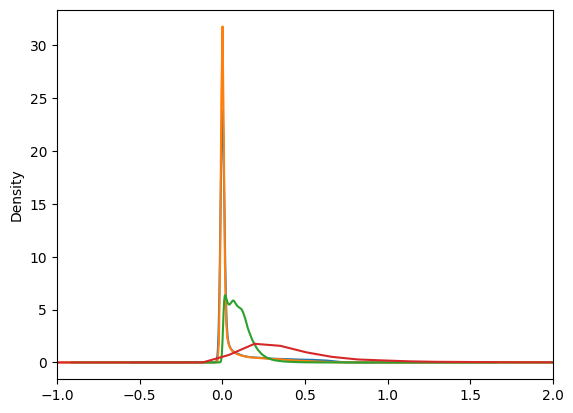

In [ ]:
df_train.target_norm[(df_train.is_consumption==0) & (df_train.is_business==0)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==0) & (df_train.is_business==1)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==1) & (df_train.is_business==0)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==1) & (df_train.is_business==1)].plot(kind = 'kde', xlim=(-1, 2))

<Axes: ylabel='Density'>

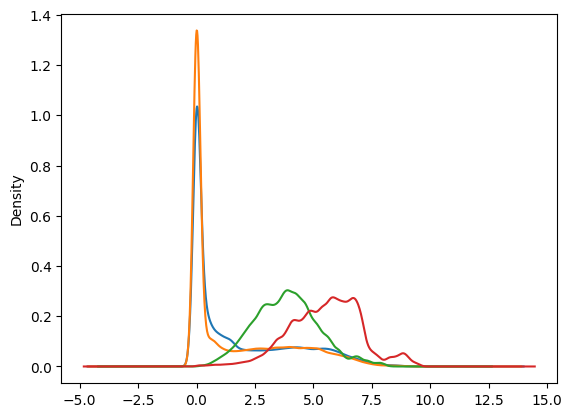

In [ ]:
df_train.target_log[(df_train.is_consumption==0) & (df_train.is_business==0)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==0) & (df_train.is_business==1)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==1) & (df_train.is_business==0)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==1) & (df_train.is_business==1)].plot(kind = 'kde',) #xlim=(-1, 2))

In [ ]:
for i in [0, 1]:
    for j in [0, 1]:
        print(df_train[(df_train.is_consumption==i) & (df_train.is_business==j)].shape[0])

465429
539163
465429
539163
